In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import math
import numpy as np

In [2]:
# Seleccionamos HISTORIC DATA 2019 ELECTROLINERES AMB.csv porque Charge2019_EV_AMB.csv no tiene la hora
Bcn_data = pd.read_csv("HISTORIC DATA 2019 ELECTROLINERES AMB.csv", encoding='latin-1',sep=";")
Bcn_data.columns

Index(['CHARGING POINT', 'CONNECTOR', 'START TIME', 'STOP TIME',
       'DURATION (min)', 'CONSUMPTION (kWh)', 'VEHICLE', 'MODEL'],
      dtype='object')

In [3]:
# Número de datos
print(f"Número de cargas (antes de limpiar): {len(Bcn_data)}")

# Número de electrolineras
print(f"Número de electrolineras: {len(Bcn_data['CHARGING POINT'].unique())}")

Número de cargas (antes de limpiar): 38219
Número de electrolineras: 21


In [4]:
# Seleccionamos solo algunas columnas
Bcn_data = Bcn_data[['CHARGING POINT','START TIME',"STOP TIME",'DURATION (min)','CONSUMPTION (kWh)']]
Bcn_data = Bcn_data.rename(columns={"CHARGING POINT": "Station", "START TIME": "Start",
                                    "STOP TIME": "Stop",
                                              "CONSUMPTION (kWh)": "Energy", "DURATION (min)": "Duration (min)"})
Bcn_data.head()

,Station,Start,Stop,Duration (min),Energy
0,PdRL L'Hospitalet de Ll.: C. Salvador Espriu -...,28/07/2019 11.25,08/08/2019 08.59,15695,0.0
1,PdRL L'Hospitalet de Ll.: C. Salvador Espriu -...,21/07/2019 11.54,24/07/2019 07.25,4052,0.0
2,PdRR Badalona: C. Anna Tugas - Pg. Olof Palmer,17/10/2019 09.08,18/10/2019 06.53,1306,0.0
3,PdRR Sant Joan Despi: C. TV3 - C. Jacint Verda...,29/09/2019 22.15,30/09/2019 11.06,772,0.0
4,PdRR Pallejà: Rda. Santa Eulalia - C. Joan Mar...,16/05/2019 20.32,17/05/2019 07.50,679,0.0


In [5]:
# Eliminamos los 0s
Bcn_data = Bcn_data[Bcn_data['Energy'] != 0]
Bcn_data.head()

,Station,Start,Stop,Duration (min),Energy
1806,FLNR Sant Andreu da la Barca: Pg. Rafael de Ca...,18/09/2019 17.05,18/09/2019 19.27,143,0.008
1807,FLNR Sant Andreu da la Barca: Pg. Rafael de Ca...,08/05/2019 16.07,08/05/2019 16.20,14,0.009
1808,PdRL Sant Joan Despí: C. TV3 - C. Jacint Verda...,12/11/2019 08.14,12/11/2019 12.10,237,0.010
1809,PdRL Sant Joan Despí: C. TV3 - C. Jacint Verda...,04/11/2019 10.54,04/11/2019 14.33,220,0.010
1810,"PdRL Gavà: C. del Progres, 54",15/03/2019 17.22,15/03/2019 20.21,180,0.010


In [6]:
# Número de datos
print(f"Número de cargas (después de limpiar): {len(Bcn_data)}")

# Número de electrolineras
print(f"Número de electrolineras: {len(Bcn_data['Station'].unique())}")

Número de cargas (después de limpiar): 36413
Número de electrolineras: 21


In [7]:
# Convertimos fecha en datetime
Bcn_data['Start'] = pd.to_datetime(Bcn_data['Start'], format="%d/%m/%Y %H.%M")  
Bcn_data['Stop'] = pd.to_datetime(Bcn_data['Stop'], format="%d/%m/%Y %H.%M") 

# Pasamos de %H:%M:%S a segundos
Bcn_data['Duration'] = Bcn_data['Duration (min)'] * 60
Bcn_data = Bcn_data.drop(columns=["Duration (min)"])

# Reordenamos índices
Bcn_data = Bcn_data.sort_values(by="Start").reset_index(drop=True)

Bcn_data.head()

,Station,Start,Stop,Energy,Duration
0,"PdRR Gavà: C. del Progres, 54",2018-12-31 00:35:00,2018-12-31 00:53:00,6.4,1140
1,"PdRR Sant Cugat del Vallès: Av. Via Augusta, 3",2018-12-31 01:21:00,2018-12-31 01:38:00,10.5,1080
2,PdRR Sant Joan Despi: C. TV3 - C. Jacint Verda...,2018-12-31 01:34:00,2018-12-31 02:03:00,14.5,1800
3,PdRR El Prat de Llobregat: Pl. Volateria (Mas ...,2018-12-31 05:46:00,2018-12-31 06:37:00,16.8,3120
4,PdRR Sant Joan Despi: C. TV3 - C. Jacint Verda...,2018-12-31 05:55:00,2018-12-31 06:18:00,9.1,1440


In [8]:
Bcn_data['Duration check'] = pd.to_timedelta(Bcn_data['Stop'] - Bcn_data['Start']).apply(pd.Timedelta.total_seconds)

In [9]:
Bcn_data

,Station,Start,Stop,Energy,Duration,Duration check
0,"PdRR Gavà: C. del Progres, 54",2018-12-31 00:35:00,2018-12-31 00:53:00,6.4,1140,1080.0
1,"PdRR Sant Cugat del Vallès: Av. Via Augusta, 3",2018-12-31 01:21:00,2018-12-31 01:38:00,10.5,1080,1020.0
2,PdRR Sant Joan Despi: C. TV3 - C. Jacint Verda...,2018-12-31 01:34:00,2018-12-31 02:03:00,14.5,1800,1740.0
3,PdRR El Prat de Llobregat: Pl. Volateria (Mas ...,2018-12-31 05:46:00,2018-12-31 06:37:00,16.8,3120,3060.0
4,PdRR Sant Joan Despi: C. TV3 - C. Jacint Verda...,2018-12-31 05:55:00,2018-12-31 06:18:00,9.1,1440,1380.0
...,...,...,...,...,...,...
36408,PdRR El Prat de Llobregat: Pl. Volateria (Mas ...,2019-12-31 20:14:00,2019-12-31 20:20:00,1.7,420,360.0
36409,"PdRR Gavà: C. del Progres, 54",2019-12-31 20:18:00,2019-12-31 20:58:00,20.4,2460,2400.0
36410,PdRR El Prat de Llobregat: Pl. Volateria (Mas ...,2019-12-31 20:35:00,2019-12-31 20:52:00,5.2,1080,1020.0
36411,PdRR l'Hospitalet de Ll.: C. Salvador Espriu -...,2019-12-31 21:25:00,2019-12-31 21:53:00,17.0,1740,1680.0


In [10]:
Bcn_data = Bcn_data[Bcn_data['Duration'] < 1.5e5]

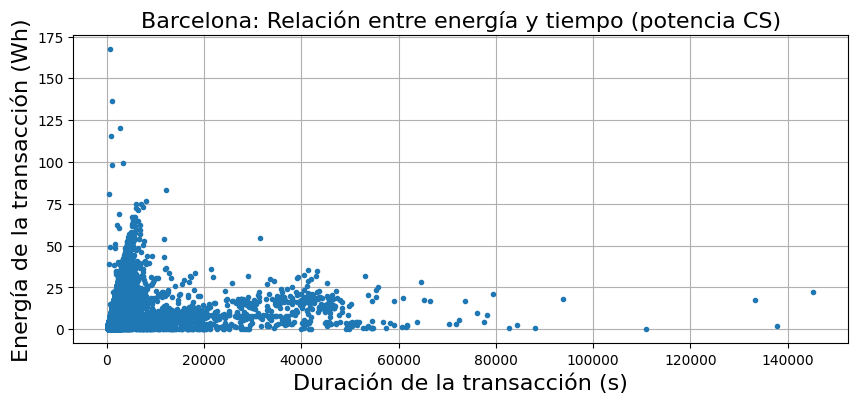

In [11]:
plt.figure(figsize=(10,4))
plt.plot(Bcn_data['Duration'],Bcn_data['Energy'],'.')
plt.title("Barcelona: Relación entre energía y tiempo (potencia CS)", size = 16)
plt.ylabel("Energía de la transacción (Wh)", size = 16)
plt.xlabel("Duración de la transacción (s)", size = 16)
plt.grid()
plt.show()

In [12]:
Bcn_data["Power"] = round(Bcn_data["Energy"]/Bcn_data["Duration"], 5) # Wh/s

/tmp/ipykernel_907/3100401261.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Bcn_data["Power"] = round(Bcn_data["Energy"]/Bcn_data["Duration"], 5) # Wh/s


In [13]:
Bcn_data

,Station,Start,Stop,Energy,Duration,Duration check,Power
0,"PdRR Gavà: C. del Progres, 54",2018-12-31 00:35:00,2018-12-31 00:53:00,6.4,1140,1080.0,0.00561
1,"PdRR Sant Cugat del Vallès: Av. Via Augusta, 3",2018-12-31 01:21:00,2018-12-31 01:38:00,10.5,1080,1020.0,0.00972
2,PdRR Sant Joan Despi: C. TV3 - C. Jacint Verda...,2018-12-31 01:34:00,2018-12-31 02:03:00,14.5,1800,1740.0,0.00806
3,PdRR El Prat de Llobregat: Pl. Volateria (Mas ...,2018-12-31 05:46:00,2018-12-31 06:37:00,16.8,3120,3060.0,0.00538
4,PdRR Sant Joan Despi: C. TV3 - C. Jacint Verda...,2018-12-31 05:55:00,2018-12-31 06:18:00,9.1,1440,1380.0,0.00632
...,...,...,...,...,...,...,...
36408,PdRR El Prat de Llobregat: Pl. Volateria (Mas ...,2019-12-31 20:14:00,2019-12-31 20:20:00,1.7,420,360.0,0.00405
36409,"PdRR Gavà: C. del Progres, 54",2019-12-31 20:18:00,2019-12-31 20:58:00,20.4,2460,2400.0,0.00829
36410,PdRR El Prat de Llobregat: Pl. Volateria (Mas ...,2019-12-31 20:35:00,2019-12-31 20:52:00,5.2,1080,1020.0,0.00481
36411,PdRR l'Hospitalet de Ll.: C. Salvador Espriu -...,2019-12-31 21:25:00,2019-12-31 21:53:00,17.0,1740,1680.0,0.00977


In [14]:
# Creamos una serie con todos los instantes de tiempo (cada segundo) de todo el mes
start = pd.Timestamp('2018-12-31 00:00:00')
end = pd.Timestamp('2019-12-31 23:59:59')
Bcn_all_secs = pd.period_range(start=start, end=end, freq='s').to_timestamp()

Bcn_stations = Bcn_data['Station'].unique()
print(f"Number of Stations: {len(Bcn_stations)}")

Number of Stations: 21


In [15]:
# Creamos el dataset con la potencia de la estación en cada momento del tiempo
Bcn_cont = pd.DataFrame(index=Bcn_all_secs)

# Asumo que Bcn_data es tu DataFrame y ya tiene las columnas mencionadas

# Convertir 'Start' y 'Stop' a datetime si no lo están
Bcn_data['Start'] = pd.to_datetime(Bcn_data['Start'])
Bcn_data['Stop'] = pd.to_datetime(Bcn_data['Stop'])

# Crear una columna 'Date' que contenga solo la fecha de 'Start'
Bcn_data['Date'] = Bcn_data['Start'].dt.date

# Agrupar por 'Station' y 'Date', y sumar la 'Energy' para cada grupo
daily_energy = Bcn_data.groupby(['Station', 'Date'])['Energy'].sum().reset_index()

# Pivotear el resultado para obtener las estaciones como columnas y los días como filas
pivot_table = daily_energy.pivot(index='Date', columns='Station', values='Energy')

# Llenar los valores NaN con 0 si es necesario
pivot_table = pivot_table.fillna(0)

pivot_table.columns = 'Station_' + pivot_table.columns.astype(str)

pivot_table

/tmp/ipykernel_907/1466889620.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Bcn_data['Start'] = pd.to_datetime(Bcn_data['Start'])
/tmp/ipykernel_907/1466889620.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Bcn_data['Stop'] = pd.to_datetime(Bcn_data['Stop'])
/tmp/ipykernel_907/1466889620.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pyd

Station,Station_FLNR Sant Andreu da la Barca: Pg. Rafael de Casanova FGC,Station_PdRL Badalona: C. Anna Tugas - Pg. Olof Palmer,"Station_PdRL Barberà del Vallés: C. Arquímedes, 8",Station_PdRL Cornellà de Llobregat: Carrer de Baltasar Oriol i Mercer,Station_PdRL El Prat de Llobregat: Pl. Volateria (Mas Blau),"Station_PdRL Gavà: C. del Progres, 54",Station_PdRL L'Hospitalet de Ll.: C. Salvador Espriu - Gran Via de les Corts Catalanes,Station_PdRL Montcada i Reixac: C. Tarragona - C. Pla de Matabous,Station_PdRL Pallejà: Rda. Santa Eulalia - C. Joan Maragall,"Station_PdRL Sant Cugat del Vallès: Av. Via Augusta, 3",...,Station_PdRR Badalona: C. Anna Tugas - Pg. Olof Palmer,"Station_PdRR Barberà del Vallés: C. Arquímedes, 8",Station_PdRR Cornellà de Llobregat: Carrer de Baltasar Oriol i Mercer,Station_PdRR El Prat de Llobregat: Pl. Volateria (Mas Blau),"Station_PdRR Gavà: C. del Progres, 54",Station_PdRR Montcada i Reixac: C. Tarragona - C. Pla de Matabous,Station_PdRR Pallejà: Rda. Santa Eulalia - C. Joan Maragall,"Station_PdRR Sant Cugat del Vallès: Av. Via Augusta, 3",Station_PdRR Sant Joan Despi: C. TV3 - C. Jacint Verdaguer,Station_PdRR l'Hospitalet de Ll.: C. Salvador Espriu - Gran Via de les Corts Catalanes
Date,,,,,,,,,,,,,,,,,,,,,
2018-12-31,0.000,2.83,0.00,3.86,0.0,3.11,0.00,0.00,5.00,0.00,...,82.8,98.8,49.2,51.9,71.0,36.2,59.6,60.2,69.4,102.8
2019-01-01,0.000,0.00,0.00,0.11,0.0,0.00,0.00,0.00,2.01,0.00,...,50.5,36.3,65.2,40.4,22.2,27.6,10.4,111.4,13.4,29.2
2019-01-02,0.000,6.07,0.00,2.99,0.0,7.52,0.00,0.04,12.61,0.00,...,75.0,92.3,86.3,96.1,153.7,8.1,77.6,98.7,47.0,79.8
2019-01-03,0.000,6.29,0.00,8.66,0.0,17.14,9.22,1.66,0.00,0.00,...,52.4,108.0,71.4,41.6,105.1,32.9,24.2,107.7,23.8,82.0
2019-01-04,0.000,4.32,0.00,0.00,0.0,13.87,1.21,1.14,2.18,0.00,...,69.3,68.2,93.5,105.8,123.8,17.7,83.9,102.6,117.7,59.9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-27,67.992,3.67,0.00,2.39,0.0,6.27,0.00,7.32,7.99,0.00,...,0.0,47.0,228.6,166.2,276.1,63.5,54.6,195.7,127.1,229.1
2019-12-28,0.000,1.37,0.00,0.75,0.0,6.58,1.41,0.00,1.90,0.00,...,0.0,21.9,106.5,91.7,184.2,13.1,140.6,110.9,98.8,122.7
2019-12-29,8.020,0.00,0.00,0.00,0.0,3.16,0.00,0.00,3.01,1.38,...,0.0,10.4,61.6,140.4,193.8,13.4,87.5,211.7,82.3,116.1


In [16]:
def plotTimeInterval(data, stations_plot, days_start=1, days_end=30, ylabel="Energy per period (Wh/period)"):

    plt.figure(figsize=(10,4))
    for stat in stations_plot:
        column_name = stat
        
        start = data.index[0] + pd.DateOffset(days=days_start-1)
        end = start + pd.DateOffset(days=days_end-1)
        plt.plot(data.loc[start:end].index, data.loc[start:end][column_name])
    plt.title(f"Energy supply between day {days_start} and day {days_end}", size = 18)
    plt.ylabel(ylabel, size = 12)
    plt.xlabel("Time", size = 12)
    plt.legend(stations_plot)
    plt.show()

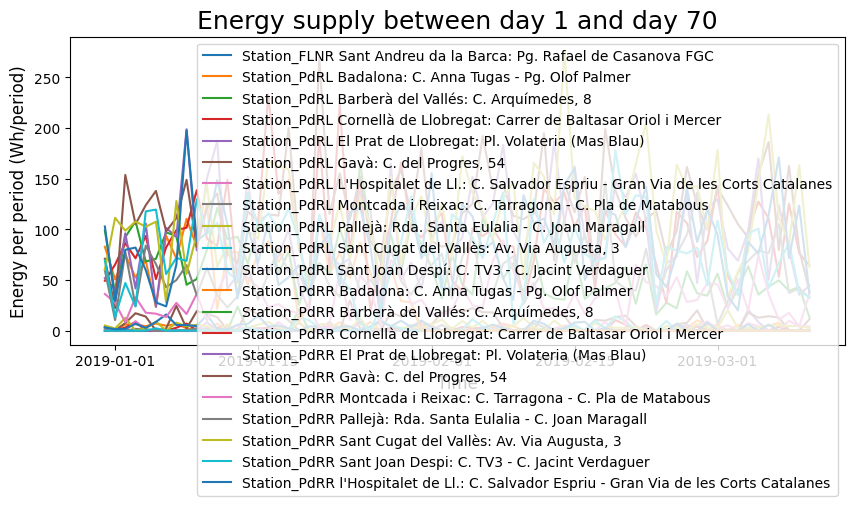

In [17]:
plotTimeInterval(pivot_table, pivot_table[0:1], days_start=1, days_end=70)

In [18]:
def plot_energy_consumption(df):
    plt.figure(figsize=(15, 10))  # Establecer el tamaño del gráfico
    for column in df.columns:
        plt.plot(df.index, df[column], label=column)  # Dibujar una línea para cada estación
        
    plt.title('Consumo de Energía por Estación a lo Largo del Tiempo')  # Título del gráfico
    plt.xlabel('Fecha')  # Etiqueta del eje X
    plt.ylabel('Energía Consumida (unidad de energía)')  # Etiqueta del eje Y
    plt.xticks(rotation=45)  # Rotar las etiquetas del eje X para mejorar legibilidad
    plt.legend()  # Mostrar la leyenda
    plt.tight_layout()  # Ajustar automáticamente los parámetros del subplot
    plt.show()

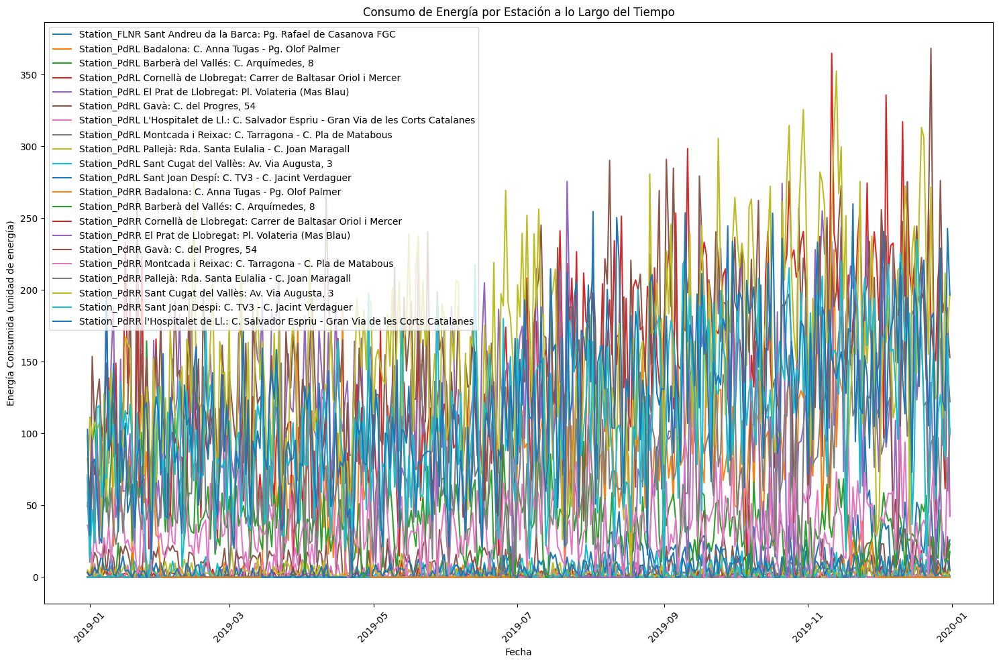

In [19]:
plot_energy_consumption(pivot_table)

In [21]:
def plot_energy_consumption_subplots(df, ncols=5):
    # Configurar el número de filas basado en el número de columnas y el total de estaciones
    nrows = int(np.ceil(len(df.columns) / ncols))
    
    # Crear una figura y un conjunto de subplots
    fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(35, nrows * 5))

    # Aplanar el array de axs para facilitar el acceso si es multidimensional
    axs = axs.ravel()
    
    # Dibujar el consumo de energía para cada estación en su propio subplot
    for i, column in enumerate(df.columns):
        axs[i].plot(df.index, df[column], label=column)
        axs[i].set_title(column)  # Establecer el nombre de la estación como título
        axs[i].set_xlabel('Fecha')
        axs[i].set_ylabel('Energía Consumida')
        axs[i].tick_params(axis='x', rotation=45)
        axs[i].legend()

    # Ocultar subplots vacíos si los hay
    for j in range(i + 1, len(axs)):
        axs[j].set_visible(False)

    # Ajustar el layout de la figura
    plt.suptitle('Consumo de Energía por Estación a lo Largo del Tiempo', fontsize=16)
    plt.show()

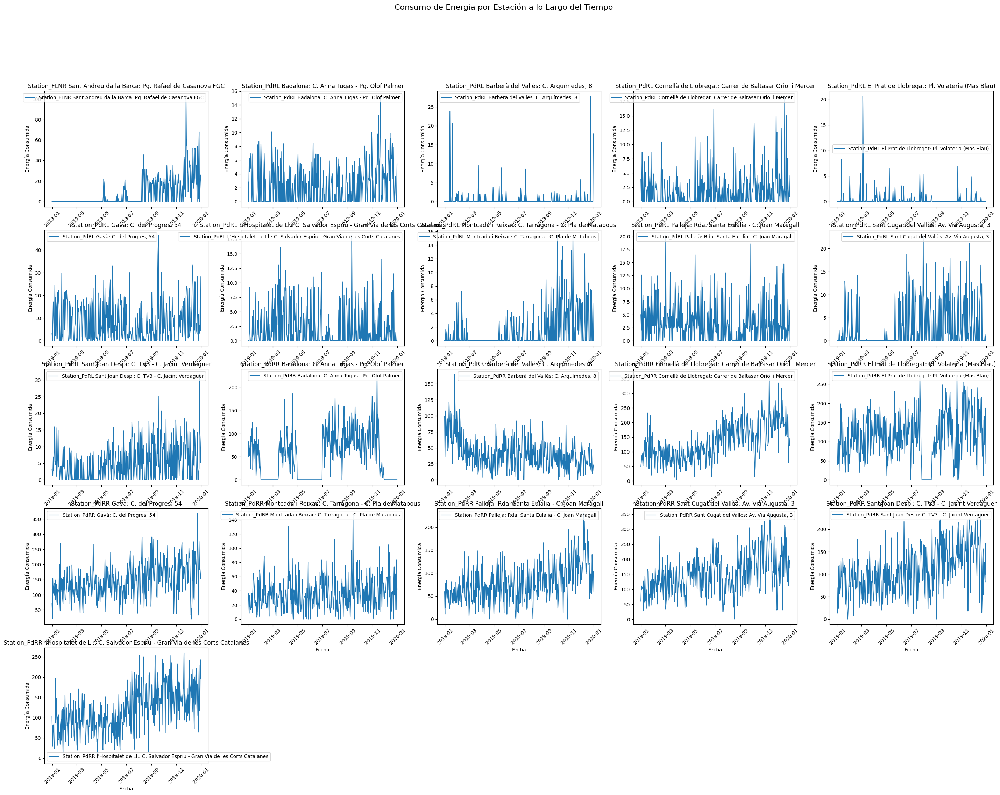

In [22]:
plot_energy_consumption_subplots(pivot_table, ncols=5)

In [23]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

def plot_moving_averages_subplot(df, ax, station, window=7, color='blue'):
    moving_average = df[station].rolling(window=window, center=True).mean()
    ax.plot(df.index, moving_average, label=station, color=color)
    ax.set_title(station)  # Establecer el título del subplot con el nombre de la estación
    ax.set_xlabel('Fecha')
    ax.set_ylabel('Energía Consumida')
    ax.tick_params(axis='x', rotation=45)
    ax.legend()

### Moving Averages Subplots - Ventana de 7 dias

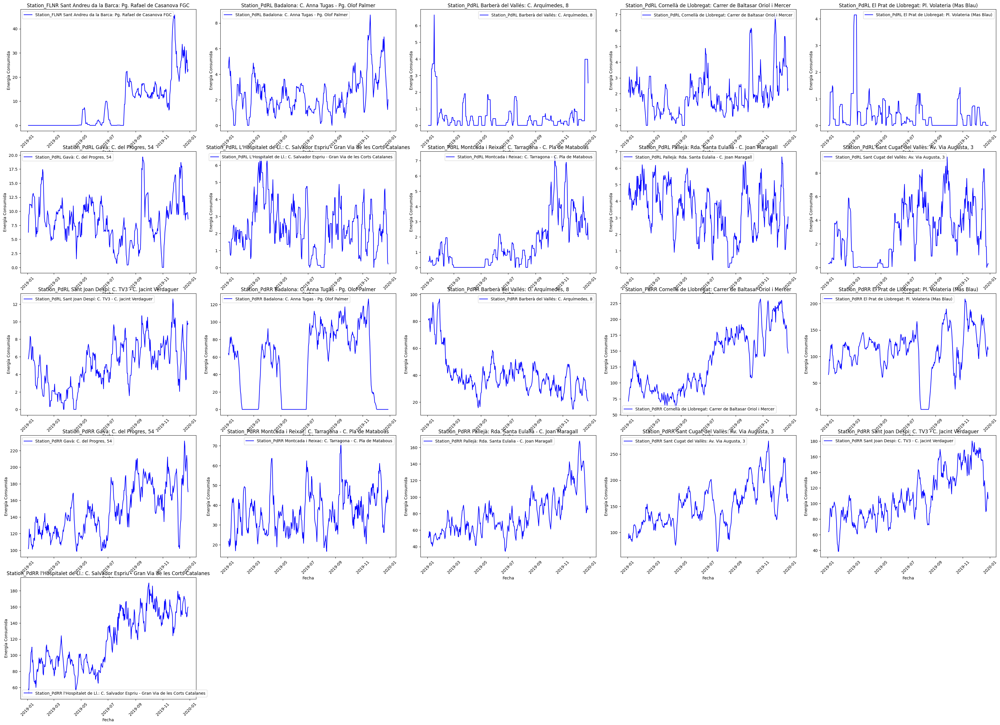

In [24]:
# Configuración de la figura y los subplots
n = len(pivot_table.columns)  # Número de estaciones
ncols = 5  # Número de columnas de subplots
nrows = int(np.ceil(n / ncols))  # Calcular el número necesario de filas

fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(35, nrows * 5))
fig.tight_layout(pad=3.0)

# Aplanar el array de axs para facilitar el acceso si es multidimensional
axs = axs.ravel()

# Generar un gráfico para cada estación
for i, station in enumerate(pivot_table.columns):
    plot_moving_averages_subplot(pivot_table, axs[i], station, window=7)

# Ocultar subplots vacíos si los hay
for j in range(i + 1, len(axs)):
    axs[j].set_visible(False)

plt.show()

### Moving Averages Subplots - Ventana de 14 dias

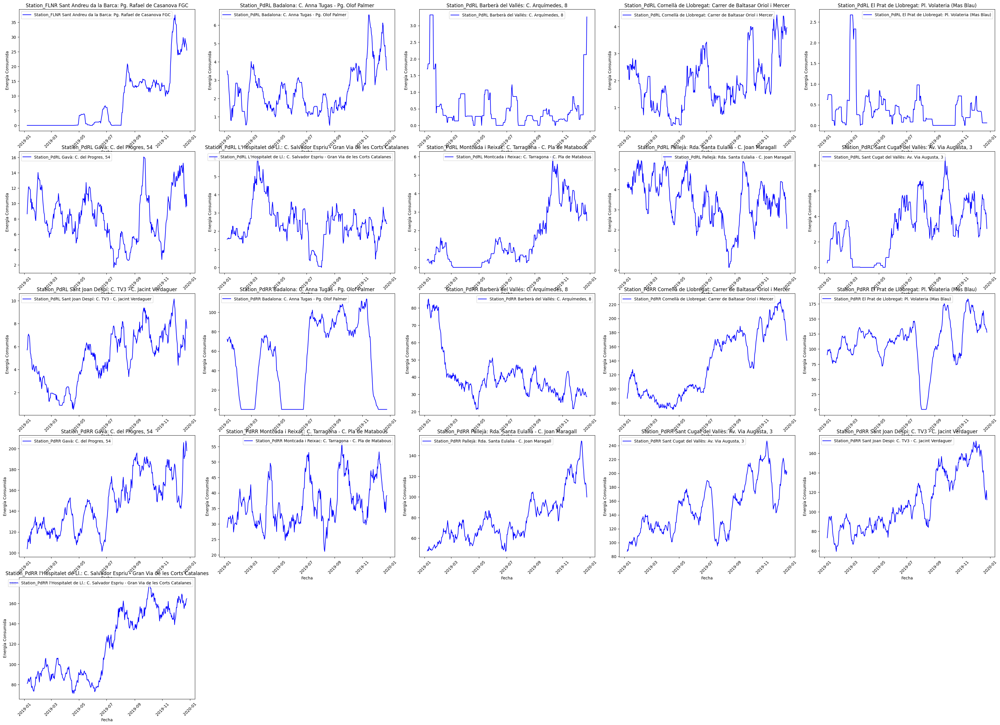

In [25]:
# Configuración de la figura y los subplots
n = len(pivot_table.columns)  # Número de estaciones
ncols = 5  # Número de columnas de subplots
nrows = int(np.ceil(n / ncols))  # Calcular el número necesario de filas

fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(35, nrows * 5))
fig.tight_layout(pad=3.0)

# Aplanar el array de axs para facilitar el acceso si es multidimensional
axs = axs.ravel()

# Generar un gráfico para cada estación
for i, station in enumerate(pivot_table.columns):
    plot_moving_averages_subplot(pivot_table, axs[i], station, window=14)

# Ocultar subplots vacíos si los hay
for j in range(i + 1, len(axs)):
    axs[j].set_visible(False)

plt.show()

### Moving Averages Subplots - Ventana de 28 dias

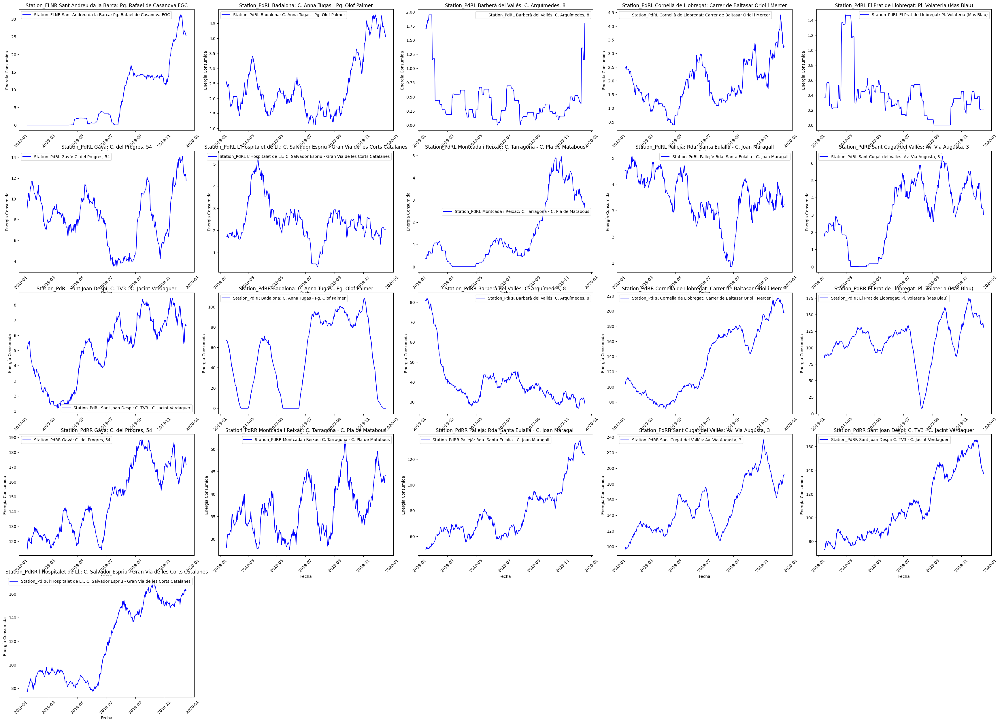

In [26]:
# Configuración de la figura y los subplots
n = len(pivot_table.columns)  # Número de estaciones
ncols = 5  # Número de columnas de subplots
nrows = int(np.ceil(n / ncols))  # Calcular el número necesario de filas

fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(35, nrows * 5))
fig.tight_layout(pad=3.0)

# Aplanar el array de axs para facilitar el acceso si es multidimensional
axs = axs.ravel()

# Generar un gráfico para cada estación
for i, station in enumerate(pivot_table.columns):
    plot_moving_averages_subplot(pivot_table, axs[i], station, window=28)

# Ocultar subplots vacíos si los hay
for j in range(i + 1, len(axs)):
    axs[j].set_visible(False)

plt.show()

### Moving Averages Subplots - Ventana de 56 dias

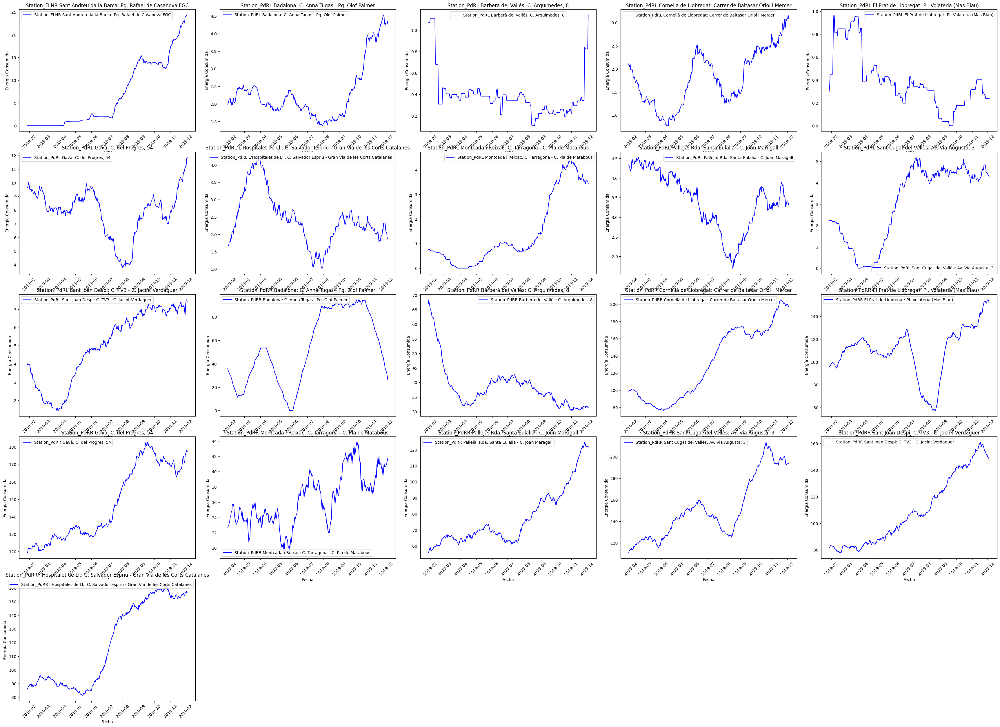

In [27]:
# Configuración de la figura y los subplots
n = len(pivot_table.columns)  # Número de estaciones
ncols = 5  # Número de columnas de subplots
nrows = int(np.ceil(n / ncols))  # Calcular el número necesario de filas

fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(35, nrows * 5))
fig.tight_layout(pad=3.0)

# Aplanar el array de axs para facilitar el acceso si es multidimensional
axs = axs.ravel()

# Generar un gráfico para cada estación
for i, station in enumerate(pivot_table.columns):
    plot_moving_averages_subplot(pivot_table, axs[i], station, window=56)

# Ocultar subplots vacíos si los hay
for j in range(i + 1, len(axs)):
    axs[j].set_visible(False)

plt.show()

## Desviacion estandar movil

In [28]:
def plot_moving_std_subplots(df, ncols=5, window=7):
    # Configurar el número de filas basado en el número de columnas y el total de estaciones
    nrows = int(np.ceil(len(df.columns) / ncols))
    
    # Crear una figura y un conjunto de subplots
    fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(35, nrows * 5), constrained_layout=True)
    fig.tight_layout(pad=3.0)
    
    # Aplanar el array de axs para facilitar el acceso si es multidimensional
    axs = axs.ravel()
    
    # Dibujar la desviación estándar móvil para cada estación en su propio subplot
    for i, column in enumerate(df.columns):
        moving_std = df[column].rolling(window=window, center=True).std()
        axs[i].plot(df.index, moving_std, label=f'Desviación Estándar {column}')
        axs[i].set_title(column)  # Establecer el nombre de la estación como título
        axs[i].set_xlabel('Fecha')
        axs[i].set_ylabel('Desviación Estándar Móvil')
        axs[i].tick_params(axis='x', rotation=45)
        axs[i].legend()

    # Ocultar subplots vacíos si los hay
    for j in range(i + 1, len(axs)):
        axs[j].set_visible(False)

    # Ajustar el layout de la figura
    plt.suptitle('Desviación Estándar Móvil de la Energía Consumida por Estación', fontsize=16)
    plt.show()

### Ventana a 7 dias

/tmp/ipykernel_907/1315727627.py:7: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.tight_layout(pad=3.0)


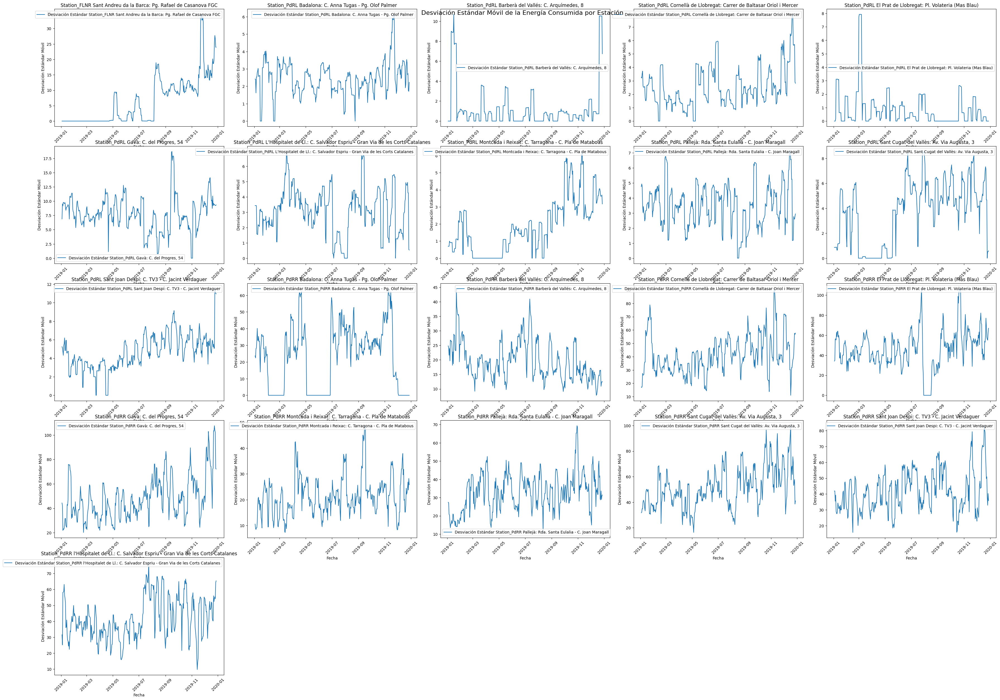

In [29]:
plot_moving_std_subplots(pivot_table, ncols=5, window=7)

### Ventana a 14 dias

/tmp/ipykernel_907/1315727627.py:7: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.tight_layout(pad=3.0)


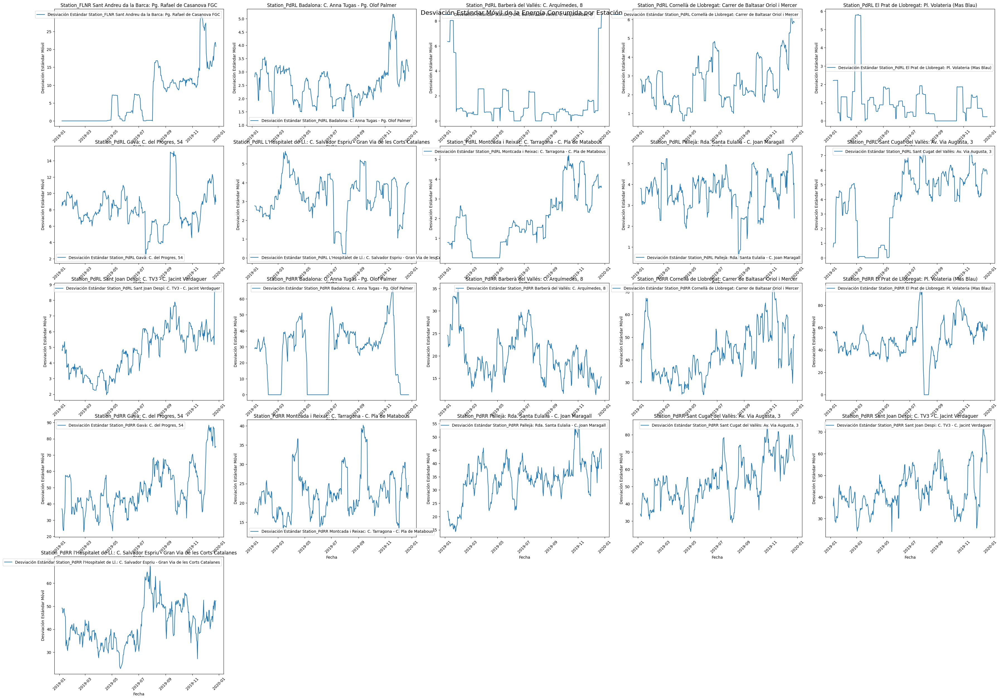

In [30]:
plot_moving_std_subplots(pivot_table, ncols=5, window=14)

### Ventana a 28 dias

/tmp/ipykernel_907/1315727627.py:7: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.tight_layout(pad=3.0)


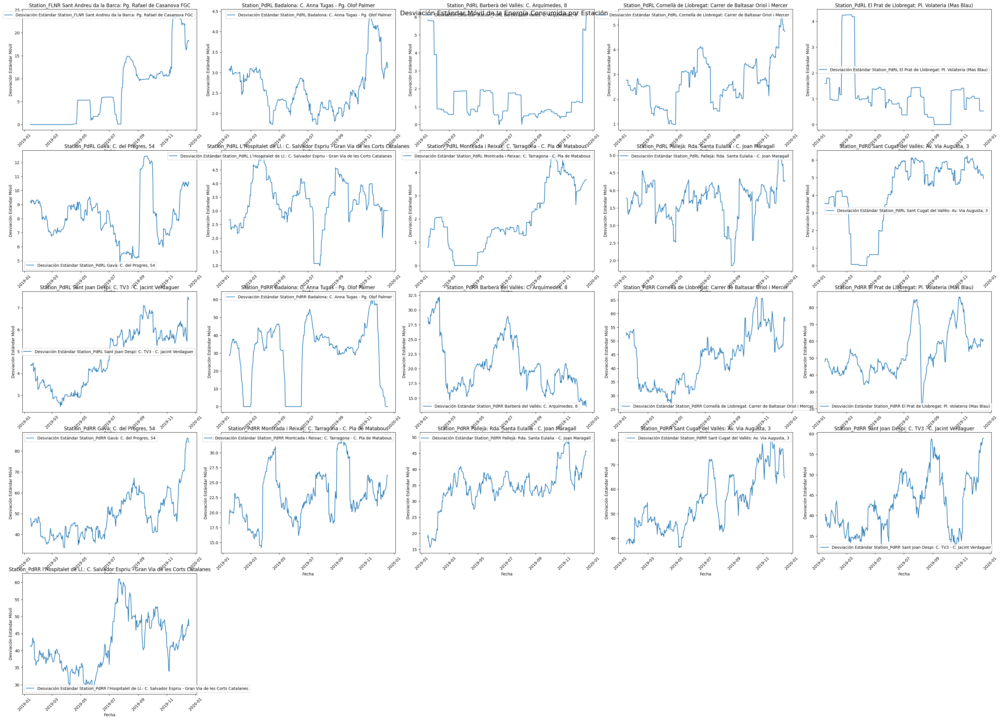

In [31]:
plot_moving_std_subplots(pivot_table, ncols=5, window=28)

### Ventana a 56 dias

/tmp/ipykernel_907/1315727627.py:7: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.tight_layout(pad=3.0)


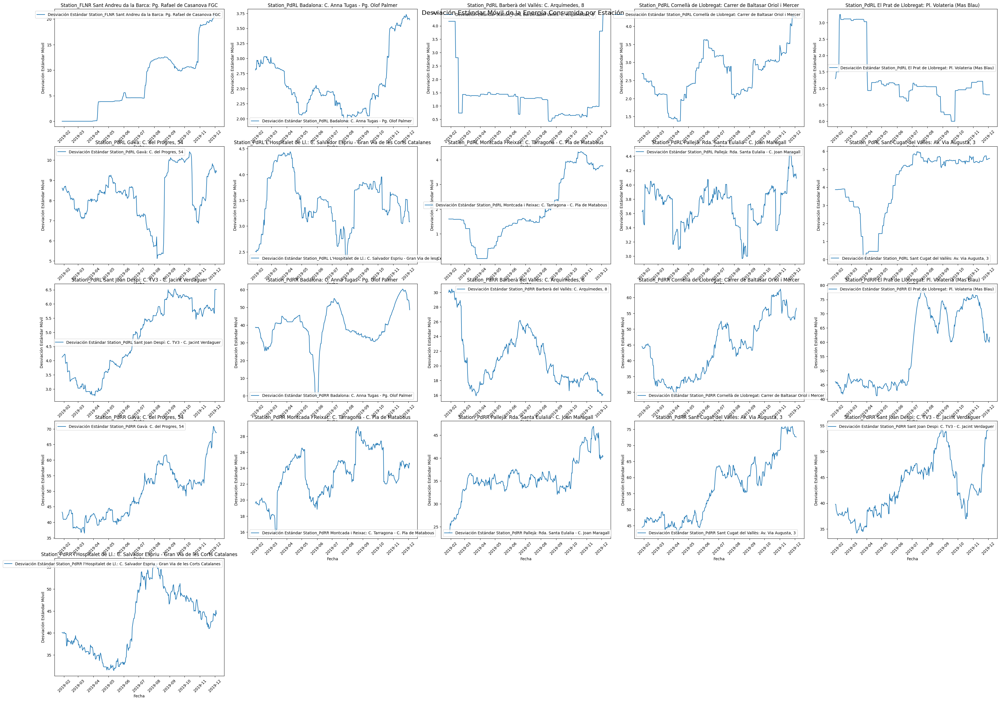

In [32]:
plot_moving_std_subplots(pivot_table, ncols=5, window=56)

## Autocorrelacion

In [33]:
from statsmodels.graphics.tsaplots import plot_acf


def plot_autocorrelation_subplots(df, ncols=5):
    # Configurar el número de filas basado en el número de columnas y el total de estaciones
    nrows = int(np.ceil(len(df.columns) / ncols))
    
    # Crear una figura y un conjunto de subplots
    fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(35, nrows * 5), constrained_layout=True)
    
    # Aplanar el array de axs para facilitar el acceso si es multidimensional
    axs = axs.ravel()
    
    # Calcular y dibujar la función de autocorrelación para cada estación
    for i, column in enumerate(df.columns):
        # Usar plot_acf de statsmodels para graficar la autocorrelación
        plot_acf(df[column], ax=axs[i], lags=30, alpha=0.05, title=f'Autocorrelación para {column}')
        axs[i].set_xlabel('Lag')
        axs[i].set_ylabel('Autocorrelación')
        axs[i].set_title(column)

    # Ocultar subplots vacíos si los hay
    for j in range(i + 1, len(axs)):
        axs[j].set_visible(False)

    # Ajustar el layout de la figura
    plt.suptitle('Autocorrelación de la Energía Consumida por Estación', fontsize=20)
    plt.show()

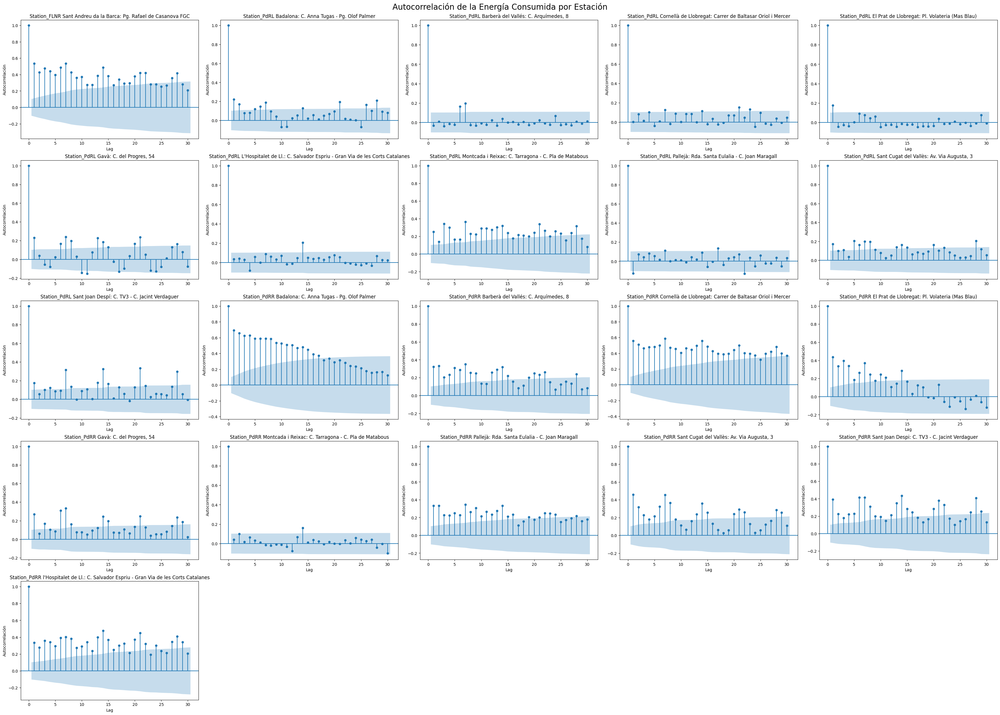

In [34]:
plot_autocorrelation_subplots(pivot_table, ncols=5)

## Seasons

### Season - Mes

In [35]:

def plot_seasonality_by_month(df, ncols=5):
    # Asegurarse de que 'Date' es tipo datetime
    df.index = pd.to_datetime(df.index)
    
    # Crear una columna 'Month' para cada fila en el DataFrame original
    df['Month'] = df.index.month
    
    # Configurar el número de filas basado en el número de columnas y el total de estaciones
    nrows = int(np.ceil(len(df.columns[:-1]) / ncols))  # Excluir la columna 'Month' recién añadida
    
    # Crear una figura y un conjunto de subplots
    fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(35, nrows * 5), constrained_layout=True)
    
    # Aplanar el array de axs para facilitar el acceso si es multidimensional
    axs = axs.ravel()
    
    # Calcular y dibujar el consumo de energía promedio por mes para cada estación
    for i, column in enumerate(df.columns[:-1]):  # Excluir la columna 'Month'
        monthly_avg = df.groupby('Month')[column].mean()
        axs[i].bar(monthly_avg.index, monthly_avg.values)
        axs[i].set_title(column)
        axs[i].set_xlabel('Mes')
        axs[i].set_ylabel('Energía Consumida Promedio')
        axs[i].set_xticks(range(1, 13))  # Asegurar que se muestren todos los meses
        axs[i].set_xticklabels(['Ene', 'Feb', 'Mar', 'Abr', 'May', 'Jun', 'Jul', 'Ago', 'Sep', 'Oct', 'Nov', 'Dic'])

    # Ocultar subplots vacíos si los hay
    for j in range(i + 1, len(axs)):
        axs[j].set_visible(False)

    df.drop(['Month'], axis=1)
    # Ajustar el layout de la figura
    plt.suptitle('Energía Consumida Promedio por Mes y Estación', fontsize=20)
    plt.show()

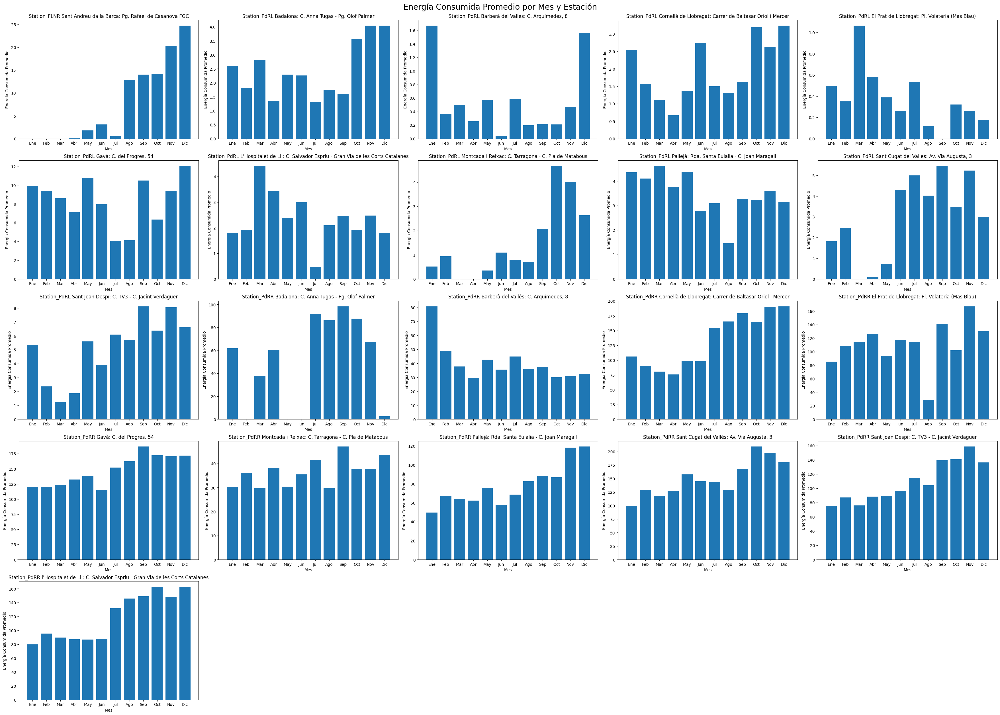

In [36]:
plot_seasonality_by_month(pivot_table, ncols=5)

### Season - Dia de la semana

In [37]:
def plot_seasonality_by_weekday(df, ncols=5):
    # Asegurarse de que 'Date' es tipo datetime
    df.index = pd.to_datetime(df.index)
    
    # Crear una columna 'Weekday' para cada fila en el DataFrame original
    # Donde 0 es lunes y 6 es domingo
    df['Weekday'] = df.index.weekday
    
    # Configurar el número de filas basado en el número de columnas y el total de estaciones
    nrows = int(np.ceil(len(df.columns[:-1]) / ncols))  # Excluir la columna 'Weekday' recién añadida
    
    # Crear una figura y un conjunto de subplots
    fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(35, nrows * 5), constrained_layout=True)
    
    # Aplanar el array de axs para facilitar el acceso si es multidimensional
    axs = axs.ravel()
    
    # Calcular y dibujar el consumo de energía promedio por día de la semana para cada estación
    for i, column in enumerate(df.columns[:-1]):  # Excluir la columna 'Weekday'
        weekday_avg = df.groupby('Weekday')[column].mean()
        axs[i].bar(weekday_avg.index, weekday_avg.values)
        axs[i].set_title(column)
        axs[i].set_xlabel('Día de la Semana')
        axs[i].set_ylabel('Energía Consumida Promedio')
        axs[i].set_xticks(range(0, 7))  # Asegurar que se muestren todos los días de la semana
        axs[i].set_xticklabels(['Lun', 'Mar', 'Mié', 'Jue', 'Vie', 'Sáb', 'Dom'])

    # Ocultar subplots vacíos si los hay
    for j in range(i + 1, len(axs)):
        axs[j].set_visible(False)

    # Ajustar el layout de la figura
    plt.suptitle('Energía Consumida Promedio por Día de la Semana y Estación', fontsize=20)
    plt.show()

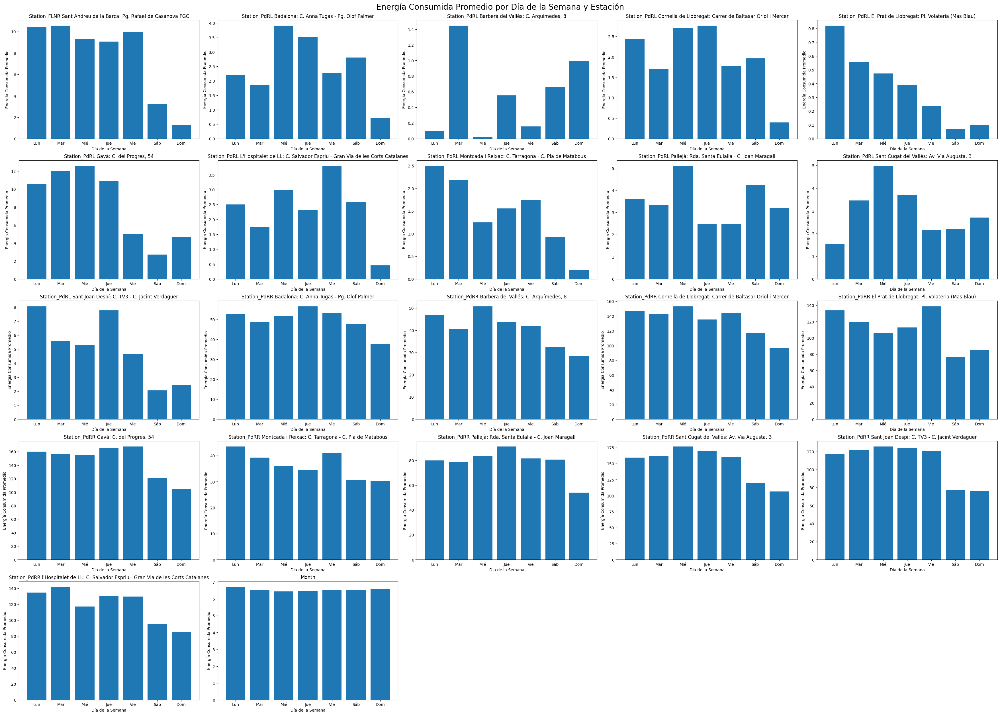

In [38]:
plot_seasonality_by_weekday(pivot_table, ncols=5)

## Descomposicion STL

In [39]:
from statsmodels.tsa.seasonal import STL
import matplotlib.pyplot as plt
import numpy as np

def plot_all_stl_decomposition(df, ncols=3, seasonal=12):
    n = len(df.columns)  # Número total de estaciones
    nrows = n  # Una fila por estación
    
    fig, axs = plt.subplots(nrows, ncols, figsize=(35, nrows * 2.5), constrained_layout=True)
    
    if n == 1:  # Si solo hay una serie, axs no es un array 2D
        axs = [axs]
    
    for i, column in enumerate(df.columns):
        # Realizar la descomposición STL para cada columna
        stl = STL(df[column], seasonal=seasonal)
        result = stl.fit()
        
        # Configurar el índice para el subplot actual basado en la estación
        ax_index = i * ncols
        
        # Tendencia
        axs[i][0].plot(result.trend)
        axs[i][0].set_title(f'Tendencia para {column}')
        axs[i][0].set_ylabel('Tendencia')
        
        # Estacionalidad
        axs[i][1].plot(result.seasonal)
        axs[i][1].set_title(f'Estacionalidad para {column}')
        axs[i][1].set_ylabel('Estacionalidad')

        # Residuo
        axs[i][2].plot(result.resid)
        axs[i][2].set_title(f'Residuo para {column}')
        axs[i][2].set_ylabel('Residuo')

    plt.suptitle('Descomposición STL de la Energía Consumida por Estación', fontsize=24)
    plt.show()




### Seasonal 7

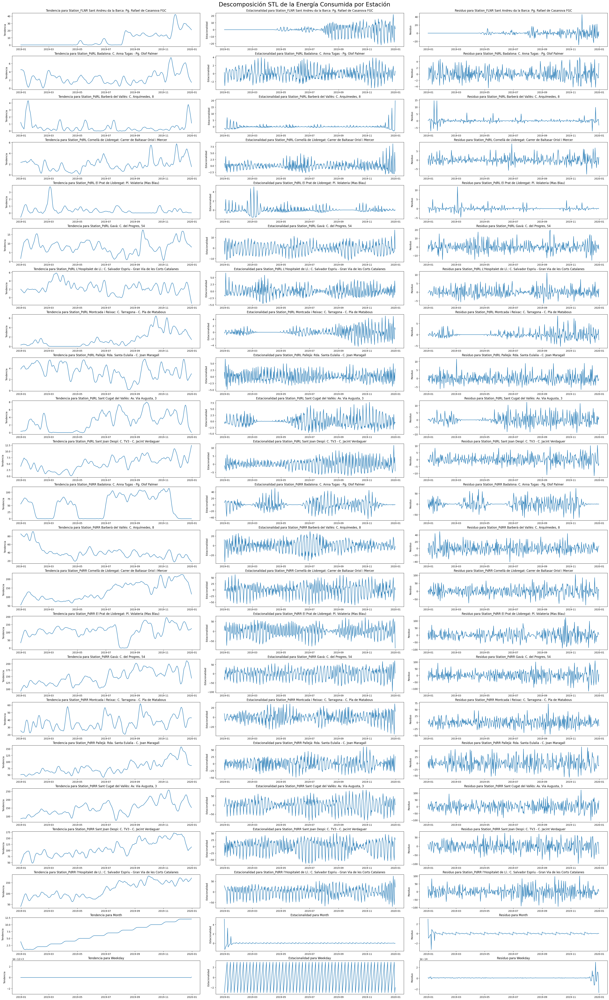

In [40]:
plot_all_stl_decomposition(pivot_table, seasonal=7)

### Seasonal 13

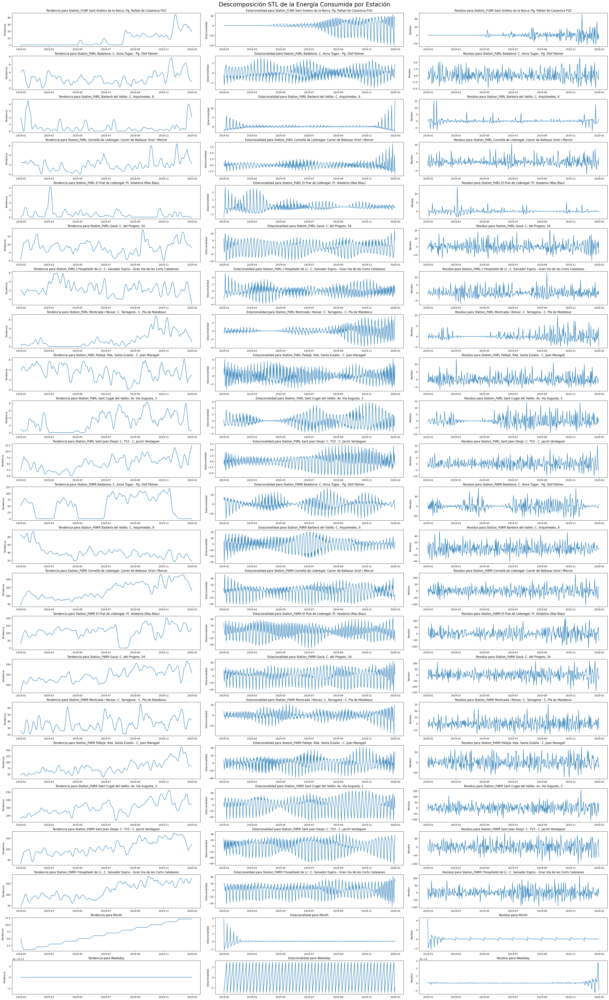

In [41]:
plot_all_stl_decomposition(pivot_table, seasonal=13)

### Seasonal 31

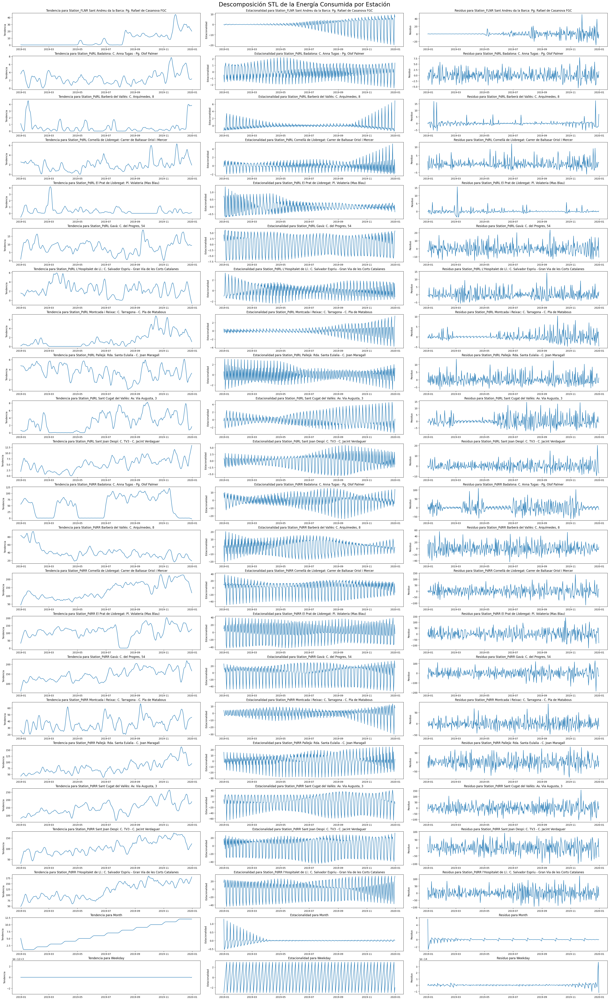

In [42]:
# Llamar a la función con el DataFrame pivot_table como argumento
plot_all_stl_decomposition(pivot_table, seasonal=31)

In [43]:
pivot_table.columns

Index(['Station_FLNR Sant Andreu da la Barca: Pg. Rafael de Casanova FGC',
       'Station_PdRL Badalona: C. Anna Tugas - Pg. Olof Palmer',
       'Station_PdRL Barberà del Vallés: C. Arquímedes, 8',
       'Station_PdRL Cornellà de Llobregat: Carrer de Baltasar Oriol i Mercer',
       'Station_PdRL El Prat de Llobregat: Pl. Volateria (Mas Blau)',
       'Station_PdRL Gavà: C. del Progres, 54',
       'Station_PdRL L'Hospitalet de Ll.: C. Salvador Espriu - Gran Via de les Corts Catalanes',
       'Station_PdRL Montcada i Reixac: C. Tarragona - C. Pla de Matabous',
       'Station_PdRL Pallejà: Rda. Santa Eulalia - C. Joan Maragall',
       'Station_PdRL Sant Cugat del Vallès: Av. Via Augusta, 3',
       'Station_PdRL Sant Joan Despí: C. TV3 - C. Jacint Verdaguer',
       'Station_PdRR Badalona: C. Anna Tugas - Pg. Olof Palmer',
       'Station_PdRR Barberà del Vallés: C. Arquímedes, 8',
       'Station_PdRR Cornellà de Llobregat: Carrer de Baltasar Oriol i Mercer',
       'Station_PdRR

# Dummy Model

## 1. Preparacion de los datos

In [44]:
from statsmodels.tsa.seasonal import STL
import pandas as pd

# Configuración inicial
lookback = 31  # Número de días hacia atrás para usar como características
pred_window = 1  # Número de días hacia adelante para predecir

# Generar características basadas en la media móvil y STL
def generate_features_with_lag(df, lookback, lags, seasonal=13):
    features = pd.DataFrame(index=df.index)
    # Generar características de lag
    for lag in range(1, lags + 1):
        for column in df.columns:
            features[f'{column}_lag_{lag}'] = df[column].shift(lag)
            
    # Media móvil y descomposición STL
    for column in df.columns:
        features[f'{column}_MA'] = df[column].rolling(window=lookback).mean()
        
        stl = STL(df[column], period=seasonal, robust=True)
        result = stl.fit()
        features[f'{column}_Trend'] = result.trend
        features[f'{column}_Seasonal'] = result.seasonal
        
    # Eliminar filas con NaN creadas por lags y medias móviles
    features.dropna(inplace=True)
    return features

features = generate_features_with_lag(pivot_table, lookback, lags=1, seasonal=13)

## 2. Generación de Ejemplos de Entrenamiento y Test

In [45]:
def create_dataset(X, y, lookback, pred_window):
    Xs, ys = [], []
    for i in range(len(X) - lookback - pred_window + 1):
        v = X.iloc[i:(i + lookback)].values
        Xs.append(v)
        ys.append(y.iloc[i + lookback:i + lookback + pred_window].values)
    return np.array(Xs), np.array(ys)

X, y = create_dataset(features, pivot_table, lookback, pred_window)

## 3. Entrenamiento del Modelo

In [46]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
import numpy as np

# Asumiendo que `features` es tu conjunto de características y `pivot_table` tus objetivos
X = features.values
# `y` debería ser ajustado para incluir solo los valores objetivo después de eliminar NaN en `features`
y = pivot_table.loc[features.index].values

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print(f'X_train: ', X_train.shape)
print(f'X_test: ', X_test.shape)
print(f'y_train: ', y_train.shape)
print(f'X_test: ', y_test.shape)

# Entrenamiento de un modelo (ejemplo con RandomForest)
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Predicción (secuencial para forecasting)
# Este es un esbozo de cómo podrías hacer predicciones secuenciales
def sequential_prediction(model, X_input, steps=7):
    predictions = []
    X_temp = X_input.copy()
    for i in range(steps):
        # Asegurarse de que X_temp es bidimensional
        pred = model.predict(X_temp.reshape(1, -1))[0]
        predictions.append(pred)
        # Aquí necesitas actualizar X_temp con la nueva predicción antes de la siguiente iteración
        # Esto puede incluir desplazar las características de lag y agregar la nueva predicción
        # Asegúrate de que X_temp se mantiene como un array de NumPy de una dimensión para coincidir con la expectativa
    return predictions

def predict_next_day(model, X):
    """
    Predice el valor del día siguiente para cada instancia en X.
    
    :param model: El modelo entrenado para hacer las predicciones.
    :param X: Array de características de entrada.
    :return: Array de predicciones para el día siguiente.
    """
    # Asegurarse de que X es bidimensional
    predictions = model.predict(X)
    # Retornar solo la primera predicción de cada conjunto de predicciones
    return predictions[:, 0]


# Predicciones para el conjunto de entrenamiento y prueba
preds_train = predict_next_day(model, X_train)
preds_test = predict_next_day(model, X_test)

# Calcular y mostrar el MSE para el conjunto de entrenamiento
mse_train = mean_squared_error(y_train[:, 0], preds_train)
print(f'MSE (Train): {mse_train}')

# Calcular y mostrar el MSE para el conjunto de prueba
mse_test = mean_squared_error(y_test[:, 0], preds_test)
print(f'MSE (Test): {mse_test}')


X_train:  (268, 92)
X_test:  (68, 92)
y_train:  (268, 23)
X_test:  (68, 23)
MSE (Train): 9.615144010386556
MSE (Test): 138.5086072720809


In [47]:
features = generate_features_with_lag(pivot_table, lookback=31, lags=1, seasonal=13)

In [48]:
def create_station_specific_datasets(features, pivot_table, lookback, pred_window):
    station_datasets = {}
    for column in pivot_table.columns:
        # Filtrar las características para la estación actual
        station_features = features.filter(regex=f'^{column}').values
        
        # Extraer los valores objetivo para la estación actual
        station_targets = pivot_table[column].values[lookback + pred_window - 1:]
        
        # Crear el dataset X, y para la estación actual
        X, y = [], []
        for i in range(len(station_features) - lookback - pred_window + 1):
            X.append(station_features[i:(i + lookback)])
            y.append(station_targets[i:i + pred_window])
        
        X = np.array(X)
        y = np.array(y)
        
        # Almacenar el dataset en el diccionario
        station_datasets[column] = (X, y)
    
    return station_datasets

# Generar datasets específicos de la estación
station_datasets = create_station_specific_datasets(features, pivot_table, lookback=31, pred_window=7)


In [49]:
from sklearn.metrics import mean_squared_error

# Dividir los datos, entrenar un modelo para cada estación, y hacer predicciones
models = {}
preds_train = {}
preds_test = {}
mse_train = {}
mse_test = {}

for column in pivot_table.columns:
    # Asumiendo que ya has generado las características para cada estación en 'features'
    X = features.filter(regex=f'^{column}').values
    y = pivot_table[column].values
    
    y_adjusted = pivot_table.loc[features.index, column].values

    # Ahora 'y_adjusted' debería tener el mismo número de muestras que 'X'
    # y puedes proceder a dividir los datos en conjuntos de entrenamiento y prueba:
    X_train, X_test, y_train, y_test = train_test_split(X, y_adjusted, test_size=0.2, random_state=42)
    
    # Entrenar el modelo
    model = RandomForestRegressor(n_estimators=100, random_state=42)
    model.fit(X_train, y_train)
    
    # Almacenar el modelo
    models[column] = model
    
    # Realizar predicciones
    preds_train[column] = predict_next_day(model, X_train)
    preds_test[column] = predict_next_day(model, X_test)
    
    # Calcular y almacenar MSE
    mse_train[column] = mean_squared_error(y_train, preds_train[column])
    mse_test[column] = mean_squared_error(y_test, preds_test[column])

# Mostrar el MSE para cada estación
for column in pivot_table.columns:
    print(f'{column} - MSE (Train): {mse_train[column]}, MSE (Test): {mse_test[column]}')

IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

In [ ]:
import matplotlib.pyplot as plt

def plot_prediction_vs_real_single(preds, real, title='Predicción vs Real'):
    plt.figure(figsize=(20, 6))
    plt.plot(real, label='Real')
    plt.plot(preds, label='Predicción', marker='x')
    plt.title(title)
    plt.xlabel('Instancia')
    plt.ylabel('Valor')
    plt.legend()
    plt.show()

# Visualización para el conjunto de prueba
plot_prediction_vs_real_single(preds_test, y_test[:, 0], title='Predicción vs Real (Test)')

# Y para el conjunto de entrenamiento
plot_prediction_vs_real_single(preds_train, y_train[:, 0], title='Predicción vs Real (Train)')


In [ ]:
# Los nombres de las estaciones correspondientes
station_names = list(pivot_table.columns)

# Llamada a la función para el conjunto de prueba
plot_predictions_vs_real(preds_train, y_train, station_names, dataset_type='Train')

# Y para el conjunto de entrenamiento
plot_predictions_vs_real(preds_test, y_test, station_names, dataset_type='Test')